In [ ]:
## Testing that hurricane track code will run on google colab..
## Then try to map chicago neighborhoods with matplotlib / geojson

In [ ]:
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (8, 3)

In [ ]:
!pip install  basemap

In [ ]:
import pandas as pd
s = pd.read_csv("https://vincentarelbundock.github.io/Rdatasets/csv/dplyr/storms.csv")
s.head()

,rownames,name,year,month,day,hour,lat,long,status,category,wind,pressure,tropicalstorm_force_diameter,hurricane_force_diameter
0,1,Amy,1975,6,27,0,27.5,-79.0,tropical depression,NaN,25,1013,NaN,NaN
1,2,Amy,1975,6,27,6,28.5,-79.0,tropical depression,NaN,25,1013,NaN,NaN
2,3,Amy,1975,6,27,12,29.5,-79.0,tropical depression,NaN,25,1013,NaN,NaN
3,4,Amy,1975,6,27,18,30.5,-79.0,tropical depression,NaN,25,1013,NaN,NaN
4,5,Amy,1975,6,28,0,31.5,-78.8,tropical depression,NaN,25,1012,NaN,NaN


In [ ]:
charley = s.query("name == 'Charley' & year == 2004")
charley.head()

,rownames,name,year,month,day,hour,lat,long,status,category,wind,pressure,tropicalstorm_force_diameter,hurricane_force_diameter
9501,9502,Charley,2004,8,9,12,11.4,-59.2,tropical depression,NaN,30,1010,0.0,0.0
9502,9503,Charley,2004,8,9,18,11.7,-61.1,tropical depression,NaN,30,1009,0.0,0.0
9503,9504,Charley,2004,8,10,0,12.2,-63.2,tropical depression,NaN,30,1009,0.0,0.0
9504,9505,Charley,2004,8,10,6,12.9,-65.3,tropical storm,NaN,35,1007,75.0,0.0
9505,9506,Charley,2004,8,10,12,13.8,-67.6,tropical storm,NaN,40,1004,125.0,0.0


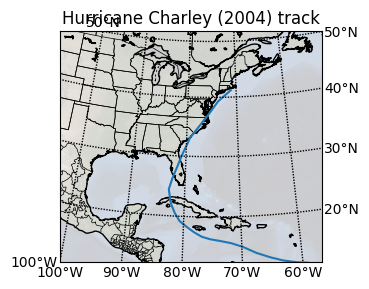

In [ ]:
# https://pythonprogramming.net/plotting-maps-python-basemap/
import mpl_toolkits
from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt
import numpy as np
def drawmap():

# some trial-and-error was needed to get a good projection
# for the North Atlantic
    m = Basemap(projection='aea', lat_0=25, lon_0 = -75,resolution='l',
                llcrnrlat=10,urcrnrlat=50,
                llcrnrlon=-100,urcrnrlon=-50)

    m.drawcoastlines()
    m.drawcountries()
    m.drawstates()

# This is the syntax to convert using the projection
# from long, lat to map coordinates
    x,y =     m(charley.long, charley.lat,)
# And this hurricane track is just an x,y scatterplot
    m.plot(x,y)
# This decorates the map with a color background image of Earth
    m.bluemarble(alpha=0.2)
    parallels = np.arange(0.,60,10.)
    m.drawparallels(parallels,labels=[False,True,True,False])
    meridians = np.arange(-20.,-140.,-10.)
    m.drawmeridians(meridians,labels=[True,False,False,True])

    plt.title("Hurricane Charley (2004) track")
    plt.show()
drawmap()

In [ ]:
!pip install geodatasets

In [ ]:
# GEOPANDAS documentation on Choropleth:
# https://geopandas.org/en/stable/docs/user_guide/mapping.html

import geodatasets
import geopandas

chicago = geopandas.read_file(geodatasets.get_path("geoda.chicago_commpop"))
groceries = geopandas.read_file(geodatasets.get_path("geoda.groceries"))


In [ ]:
chicago

,community,NID,POP2010,POP2000,POPCH,POPPERCH,popplus,popneg,geometry
0,DOUGLAS,35,18238,26470,-8232,-31.099358,0,1,"MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ..."
1,OAKLAND,36,5918,6110,-192,-3.142390,0,1,"MULTIPOLYGON (((-87.59215 41.81693, -87.59231 ..."
2,FULLER PARK,37,2876,3420,-544,-15.906433,0,1,"MULTIPOLYGON (((-87.62880 41.80189, -87.62879 ..."
3,GRAND BOULEVARD,38,21929,28006,-6077,-21.698922,0,1,"MULTIPOLYGON (((-87.60671 41.81681, -87.60670 ..."
4,KENWOOD,39,17841,18363,-522,-2.842673,0,1,"MULTIPOLYGON (((-87.59215 41.81693, -87.59215 ..."
...,...,...,...,...,...,...,...,...,...
72,MOUNT GREENWOOD,74,19093,18820,273,1.450584,1,0,"MULTIPOLYGON (((-87.69646 41.70714, -87.69644 ..."
73,MORGAN PARK,75,22544,25226,-2682,-10.631888,0,1,"MULTIPOLYGON (((-87.64215 41.68508, -87.64249 ..."
74,OHARE,76,12756,11956,800,6.691201,1,0,"MULTIPOLYGON (((-87.83658 41.98640, -87.83658 ..."
75,EDGEWATER,77,56521,62198,-5677,-9.127303,0,1,"MULTIPOLYGON (((-87.65456 41.99817, -87.65456 ..."


In [ ]:
repr(chicago.iloc[0].geometry)


'<MULTIPOLYGON (((-87.609 41.845, -87.609 41.845, -87.609 41.845, -87.609 41....>'

In [ ]:
groceries

,OBJECTID,Ycoord,Xcoord,Status,Address,Chain,Category,geometry
0,16,41.973266,-87.657073,OPEN,"1051 W ARGYLE ST, CHICAGO, IL. 60640",VIET HOA PLAZA,None,MULTIPOINT (1168268.672 1933554.350)
1,18,41.696367,-87.681315,OPEN,"10800 S WESTERN AVE, CHICAGO, IL. 60643-3226",COUNTY FAIR FOODS,None,MULTIPOINT (1162302.618 1832900.224)
2,22,41.868634,-87.638638,OPEN,"1101 S CANAL ST, CHICAGO, IL. 60607-4932",WHOLE FOODS MARKET,None,MULTIPOINT (1173317.042 1895425.426)
3,23,41.877590,-87.654953,OPEN,"1101 W JACKSON BLVD, CHICAGO, IL. 60607-2905",TARGET/SUPER,new,MULTIPOINT (1168996.475 1898801.406)
4,27,41.737696,-87.625795,OPEN,"112 W 87TH ST, CHICAGO, IL. 60620-1318",FOOD 4 LESS,None,MULTIPOINT (1176991.989 1847262.423)
...,...,...,...,...,...,...,...,...
143,585,41.880834,-87.647729,Chicago-West Loop,"40 S Halsted St, Chicago, IL 60661",Mariano's,None,MULTIPOINT (1171065.063 1899839.376)
144,586,41.920842,-87.669112,NewLocation,"2112 N Ashland Ave, Chicago IL 60614",Mariano's,None,MULTIPOINT (1165217.798 1914159.975)
145,587,41.835930,-87.664034,Chicago-Bridgeport,"3145 S Ashland Ave, Chicago, IL 60608",Mariano's,None,MULTIPOINT (1166186.713 1883581.309)
146,588,41.859370,-87.630062,Chicago-South Loop,"1615 S Clark St, Chicago, IL 60616",Mariano's,None,MULTIPOINT (1175778.816 1892214.445)


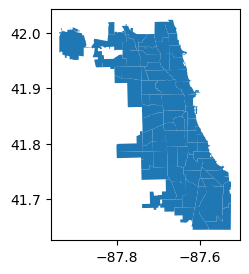

In [ ]:
chicago.plot();

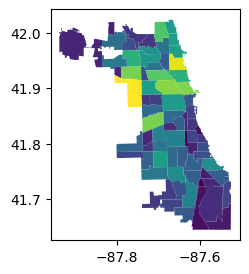

In [ ]:
chicago.plot(column="POP2010");

In [ ]:
chicago

,community,NID,POP2010,POP2000,POPCH,POPPERCH,popplus,popneg,geometry
0,DOUGLAS,35,18238,26470,-8232,-31.099358,0,1,"MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ..."
1,OAKLAND,36,5918,6110,-192,-3.142390,0,1,"MULTIPOLYGON (((-87.59215 41.81693, -87.59231 ..."
2,FULLER PARK,37,2876,3420,-544,-15.906433,0,1,"MULTIPOLYGON (((-87.62880 41.80189, -87.62879 ..."
3,GRAND BOULEVARD,38,21929,28006,-6077,-21.698922,0,1,"MULTIPOLYGON (((-87.60671 41.81681, -87.60670 ..."
4,KENWOOD,39,17841,18363,-522,-2.842673,0,1,"MULTIPOLYGON (((-87.59215 41.81693, -87.59215 ..."
...,...,...,...,...,...,...,...,...,...
72,MOUNT GREENWOOD,74,19093,18820,273,1.450584,1,0,"MULTIPOLYGON (((-87.69646 41.70714, -87.69644 ..."
73,MORGAN PARK,75,22544,25226,-2682,-10.631888,0,1,"MULTIPOLYGON (((-87.64215 41.68508, -87.64249 ..."
74,OHARE,76,12756,11956,800,6.691201,1,0,"MULTIPOLYGON (((-87.83658 41.98640, -87.83658 ..."
75,EDGEWATER,77,56521,62198,-5677,-9.127303,0,1,"MULTIPOLYGON (((-87.65456 41.99817, -87.65456 ..."


In [ ]:
# This is what you get when you search for "Chicago GEOJSON" :  the
# official shapefiles from city hall's data dungeon:
map = geopandas.read_file("https://data.cityofchicago.org/api/geospatial/bbvz-uum9?method=export&format=GeoJSON")

<Axes: >

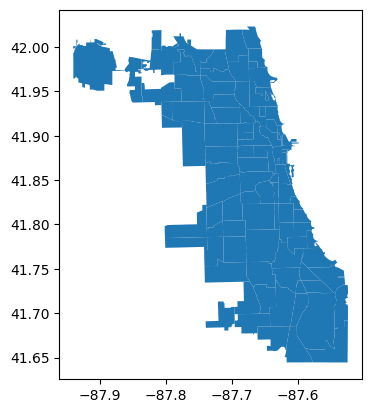

In [ ]:
map.plot()

In [ ]:
map.columns

Index(['pri_neigh', 'sec_neigh', 'shape_area', 'shape_len', 'geometry'], dtype='object')

In [ ]:
map

,pri_neigh,sec_neigh,shape_area,shape_len,geometry
0,Grand Boulevard,BRONZEVILLE,48492503.1554,28196.837157,"MULTIPOLYGON (((-87.60671 41.81681, -87.60670 ..."
1,Printers Row,PRINTERS ROW,2162137.97139,6864.247156,"MULTIPOLYGON (((-87.62761 41.87437, -87.62760 ..."
2,United Center,UNITED CENTER,32520512.7053,23101.363745,"MULTIPOLYGON (((-87.66707 41.88885, -87.66707 ..."
3,Sheffield & DePaul,SHEFFIELD & DEPAUL,10482592.2987,13227.049745,"MULTIPOLYGON (((-87.65833 41.92166, -87.65835 ..."
4,Humboldt Park,HUMBOLDT PARK,125010425.593,46126.751351,"MULTIPOLYGON (((-87.74060 41.88782, -87.74060 ..."
...,...,...,...,...,...
93,Belmont Cragin,"BELMONT CRAGIN,HERMOSA",109099407.211,43311.706886,"MULTIPOLYGON (((-87.74143 41.91698, -87.74141 ..."
94,Austin,AUSTIN,170037750.826,55473.345911,"MULTIPOLYGON (((-87.75620 41.91547, -87.75588 ..."
95,Gold Coast,GOLD COAST,7165705.53467,13685.479377,"MULTIPOLYGON (((-87.62646 41.91147, -87.62640 ..."
96,Boystown,BOYSTOWN,3365778.97115,9780.268985,"MULTIPOLYGON (((-87.64878 41.93999, -87.64927 ..."


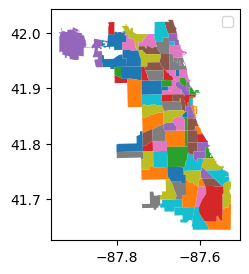

In [ ]:
map.plot(column = "shape_area")

In [ ]:
import altair as alt

In [ ]:
alt.Chart(map).mark_geoshape(
    stroke='#aaa', strokeWidth=0.25)


).transform_lookup(
    lookup='id', from_=alt.LookupData(data=unemp, key='id', fields=['rate'])
).encode(
    alt.Color('rate:Q',
              scale=alt.Scale(domain=[0, 0.3], clamp=True),
              legend=alt.Legend(format='%')),
    alt.Tooltip('rate:Q', format='.0%')
).project(
    type='albersUsa'
).properties(
    width=900,
    height=500
).configure_view(
    stroke=None
)

SyntaxError: ignored

In [ ]:
alt.Chart(map).mark_geoshape(
    stroke='#aaa', strokeWidth=0.25)

alt.Chart(...)

In [ ]:
# Merge in the data, hopefully
alt.Chart(map).mark_geoshape(
    stroke='#aaa', strokeWidth=0.25).transform_lookup(
    lookup='community', from_=alt.LookupData(data=chicago,
        key='community', fields=['POP2010']))



alt.Chart(...)

In [ ]:
chicago.head(), map.head()

(         community  NID  POP2010  POP2000  POPCH   POPPERCH  popplus  popneg  \
 0          DOUGLAS   35    18238    26470  -8232 -31.099358        0       1   
 1          OAKLAND   36     5918     6110   -192  -3.142390        0       1   
 2      FULLER PARK   37     2876     3420   -544 -15.906433        0       1   
 3  GRAND BOULEVARD   38    21929    28006  -6077 -21.698922        0       1   
 4          KENWOOD   39    17841    18363   -522  -2.842673        0       1   
 
                                             geometry  
 0  MULTIPOLYGON (((-87.60914 41.84469, -87.60915 ...  
 1  MULTIPOLYGON (((-87.59215 41.81693, -87.59231 ...  
 2  MULTIPOLYGON (((-87.62880 41.80189, -87.62879 ...  
 3  MULTIPOLYGON (((-87.60671 41.81681, -87.60670 ...  
 4  MULTIPOLYGON (((-87.59215 41.81693, -87.59215 ...  ,
             pri_neigh           sec_neigh     shape_area     shape_len  \
 0     Grand Boulevard         BRONZEVILLE  48492503.1554  28196.837157   
 1        Printers Row   

In [ ]:
map["community"] = map.sec_neigh

In [ ]:
alt.Chart(map).mark_geoshape(
    stroke='#aaa', strokeWidth=0.25)


In [ ]:
# Merge in the data, hopefully
alt.Chart(map).mark_geoshape(
    stroke='#aaa', strokeWidth=0.25).transform_lookup(
    lookup='community', from_=alt.LookupData(data=chicago,
        key='community', fields=['POP2010'])).encode(
    alt.Color('POP2010:Q'),
    )

alt.Chart(...)

In [ ]:
# That didn't merge.  Can I at least choropleth the useless numbers
# contained in map?
alt.Chart(map).mark_geoshape(
    stroke='#aaa', strokeWidth=0.25).transform_lookup(
    lookup='community', from_=alt.LookupData(data=chicago,
        key='community', fields=['POP2010'])).encode(
    alt.Color('shape_area:N'),
    )

alt.Chart(...)

In [ ]:
# Useless numbers as Q datatype?
alt.Chart(map).mark_geoshape(
    stroke='#aaa', strokeWidth=0.25).transform_lookup(
    lookup='community', from_=alt.LookupData(data=chicago,
        key='community', fields=['POP2010'])).encode(
    alt.Color('shape_area:Q'),
    )

alt.Chart(...)

In [ ]:
# So, remove tooltip?
alt.Chart(map).mark_geoshape(
    stroke='#aaa', strokeWidth=0.25).transform_lookup(
    lookup='community', from_=alt.LookupData(data=chicago,
        key='community', fields=['POP2010'])).encode(
    alt.Color('POP2010:Q'),
    )

alt.Chart(...)

In [ ]:
map.community

0                BRONZEVILLE
1               PRINTERS ROW
2              UNITED CENTER
3         SHEFFIELD & DEPAUL
4              HUMBOLDT PARK
               ...          
93    BELMONT CRAGIN,HERMOSA
94                    AUSTIN
95                GOLD COAST
96                  BOYSTOWN
97               RIVER NORTH
Name: community, Length: 98, dtype: object

In [ ]:
map.columns, chicago.columns

(Index(['pri_neigh', 'sec_neigh', 'shape_area', 'shape_len', 'geometry',
        'community'],
       dtype='object'),
 Index(['community', 'NID', 'POP2010', 'POP2000', 'POPCH', 'POPPERCH',
        'popplus', 'popneg', 'geometry'],
       dtype='object'))

In [ ]:
s1 = set( map.sec_neigh)
s2 = set( chicago.community)

In [ ]:
map["community"] = map.pri_neigh.apply(lambda x: x.upper())
map.community

0        GRAND BOULEVARD
1           PRINTERS ROW
2          UNITED CENTER
3     SHEFFIELD & DEPAUL
4          HUMBOLDT PARK
             ...        
93        BELMONT CRAGIN
94                AUSTIN
95            GOLD COAST
96              BOYSTOWN
97           RIVER NORTH
Name: community, Length: 98, dtype: object

In [ ]:
# Now, having massaged community... will it merge?
alt.Chart(map).mark_geoshape(
    stroke='#aaa', strokeWidth=0.25).transform_lookup(
    lookup='community', from_=alt.LookupData(data=chicago,
        key='community', fields=['POP2010'])).encode(
    alt.Color('POP2010:Q'),
 alt.Tooltip(['community'] )    )

alt.Chart(...)

In [ ]:
set1 = set(map.community.to_list())

In [ ]:
set2 = set (chicago.community.to_list())

In [ ]:
len(set1.intersection(set2))

68

In [ ]:
len(s1), len(s2), len(s1.intersection(s2))

(78, 77, 34)

In [ ]:
s1 - s2.intersection(s1)

{'ANDERSONVILLE',
 'ARCHER HEIGHTS,WEST ELSDON',
 'ARMOUR SQUARE,CHINATOWN',
 'AVALON PARK,CALUMET HEIGHTS',
 'BACK OF THE YARDS',
 'BELMONT CRAGIN,HERMOSA',
 'BELMONT CRAIGIN,HERMOSA',
 'BOYSTOWN',
 'BRIGHTON PARK,MCKINLEY PARK',
 'BRONZEVILLE',
 'BUCKTOWN',
 'CHATHAM,BURNSIDE',
 'GARFIELD PARK',
 'GOLD COAST',
 'GRANT PARK',
 'GREEKTOWN',
 'IRVING PARK,AVONDALE',
 'JACKSON PARK',
 'KENWOOD,OAKLAND',
 'LITTLE ITALY, UIC',
 'LITTLE VILLAGE',
 'MARQUETTE PARK,GAGE PARK',
 'MIDWAY AIRPORT',
 'MILLENIUM PARK',
 'MONTCLARE, GALEWOOD',
 'MOUNT GREENWOOD,MORGAN PARK',
 'MUSEUM CAMPUS',
 'NORTH PARK,ALBANY PARK',
 'OAKLAND,KENWOOD',
 'OLD TOWN',
 'PRINTERS ROW',
 'RIVER NORTH',
 'RUSH & DIVISION',
 'SAUGANASH,FOREST GLEN',
 'SHEFFIELD & DEPAUL',
 'SOUTH SHORE, GRAND CROSSING',
 'SOUTHEAST SIDE',
 'STREETERVILLE',
 'UKRAINIAN VILLAGE AND EAST VILLAGE',
 'UNITED CENTER',
 'WASHINGTON HEIGHTS,ROSELAND',
 'WEST LOOP',
 'WICKER PARK,WEST TOWN',
 'WRIGLEYVILLE'}

In [ ]:
s2 - s2.intersection(s1)

{'ALBANY PARK',
 'ARCHER HEIGHTS',
 'ARMOUR SQUARE',
 'AVALON PARK',
 'AVONDALE',
 'BELMONT CRAGIN',
 'BRIGHTON PARK',
 'BURNSIDE',
 'CALUMET HEIGHTS',
 'CHATHAM',
 'CHICAGO LAWN',
 'CLEARING',
 'DOUGLAS',
 'EAST GARFIELD PARK',
 'EAST SIDE',
 'FOREST GLEN',
 'FULLER PARK',
 'GAGE PARK',
 'GARFIELD RIDGE',
 'GRAND BOULEVARD',
 'GREATER GRAND CROSSING',
 'HEGEWISCH',
 'HERMOSA',
 'IRVING PARK',
 'KENWOOD',
 'MCKINLEY PARK',
 'MONTCLARE',
 'MORGAN PARK',
 'MOUNT GREENWOOD',
 'NEAR NORTH SIDE',
 'NEAR WEST SIDE',
 'NEW CITY',
 'NORTH PARK',
 'OAKLAND',
 'ROSELAND',
 'SOUTH DEERING',
 'SOUTH LAWNDALE',
 'SOUTH SHORE',
 'WASHINGTON HEIGHTS',
 'WEST ELSDON',
 'WEST ENGLEWOOD',
 'WEST GARFIELD PARK',
 'WEST TOWN'}

In [ ]:
import plotly.express as px

In [ ]:
fig = px.choropleth(map)

In [ ]:
fig.show()

In [ ]:
fig = px.choropleth(map, geojson=map.geometry)
fig.show()

In [ ]:
map

,pri_neigh,sec_neigh,shape_area,shape_len,geometry
0,Grand Boulevard,BRONZEVILLE,48492503.1554,28196.837157,"MULTIPOLYGON (((-87.60671 41.81681, -87.60670 ..."
1,Printers Row,PRINTERS ROW,2162137.97139,6864.247156,"MULTIPOLYGON (((-87.62761 41.87437, -87.62760 ..."
2,United Center,UNITED CENTER,32520512.7053,23101.363745,"MULTIPOLYGON (((-87.66707 41.88885, -87.66707 ..."
3,Sheffield & DePaul,SHEFFIELD & DEPAUL,10482592.2987,13227.049745,"MULTIPOLYGON (((-87.65833 41.92166, -87.65835 ..."
4,Humboldt Park,HUMBOLDT PARK,125010425.593,46126.751351,"MULTIPOLYGON (((-87.74060 41.88782, -87.74060 ..."
...,...,...,...,...,...
93,Belmont Cragin,"BELMONT CRAGIN,HERMOSA",109099407.211,43311.706886,"MULTIPOLYGON (((-87.74143 41.91698, -87.74141 ..."
94,Austin,AUSTIN,170037750.826,55473.345911,"MULTIPOLYGON (((-87.75620 41.91547, -87.75588 ..."
95,Gold Coast,GOLD COAST,7165705.53467,13685.479377,"MULTIPOLYGON (((-87.62646 41.91147, -87.62640 ..."
96,Boystown,BOYSTOWN,3365778.97115,9780.268985,"MULTIPOLYGON (((-87.64878 41.93999, -87.64927 ..."


In [ ]:
# Ok, the map information that is in the .geometry column is not in the
# format plotly needs to ingest



In [ ]:
# From the PLOTLY documentation:
# https://plotly.com/python/choropleth-maps/

import plotly.express as px

df = px.data.gapminder().query("year==2007")
fig = px.choropleth(df, locations="iso_alpha",
                    color="lifeExp", # lifeExp is a column of gapminder
                    hover_name="country", # column to add to hover information
                    color_continuous_scale=px.colors.sequential.Plasma)
fig.show()

In [ ]:
df

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
11,Afghanistan,Asia,2007,43.828,31889923,974.580338,AFG,4
23,Albania,Europe,2007,76.423,3600523,5937.029526,ALB,8
35,Algeria,Africa,2007,72.301,33333216,6223.367465,DZA,12
47,Angola,Africa,2007,42.731,12420476,4797.231267,AGO,24
59,Argentina,Americas,2007,75.320,40301927,12779.379640,ARG,32
...,...,...,...,...,...,...,...,...
1655,Vietnam,Asia,2007,74.249,85262356,2441.576404,VNM,704
1667,West Bank and Gaza,Asia,2007,73.422,4018332,3025.349798,PSE,275
1679,"Yemen, Rep.",Asia,2007,62.698,22211743,2280.769906,YEM,887
1691,Zambia,Africa,2007,42.384,11746035,1271.211593,ZMB,894
